In [2]:
import pandas as pd
import numpy as np


In [3]:
flights = pd.read_csv("/Users/divyanshdoshi/Desktop/DCU/dmv/opensky_flights_cleaned.csv")   # OpenSky Flight dataset
covid = pd.read_csv("/Users/divyanshdoshi/Desktop/DCU/dmv/compact.csv")          # Our World in Data COVID dataset


In [4]:
print(flights.head())
print(flights.info())

print(covid.head())
print(covid.info())


                         day country  flights continent
0  2019-01-01 00:00:00+00:00      AE      880        AS
1  2019-01-01 00:00:00+00:00      AT      248        EU
2  2019-01-01 00:00:00+00:00      BE      257        EU
3  2019-01-01 00:00:00+00:00      BG       56        EU
4  2019-01-01 00:00:00+00:00      BH      109        AS
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 92555 entries, 0 to 92554
Data columns (total 4 columns):
 #   Column     Non-Null Count  Dtype 
---  ------     --------------  ----- 
 0   day        92555 non-null  object
 1   country    92555 non-null  object
 2   flights    92555 non-null  int64 
 3   continent  92555 non-null  object
dtypes: int64(1), object(3)
memory usage: 2.8+ MB
None
       country        date  total_cases  new_cases  new_cases_smoothed  \
0  Afghanistan  2020-01-01          NaN        NaN                 NaN   
1  Afghanistan  2020-01-02          NaN        NaN                 NaN   
2  Afghanistan  2020-01-03          NaN      

In [5]:
# Rename flight 'day' column to 'date'
flights = flights.rename(columns={'day': 'date'})

# Keep only columns needed
flights = flights[['date', 'country', 'flights', 'continent']]
covid = covid[['date', 'country', 'new_cases', 'stringency_index']]


In [6]:
flights['date'] = pd.to_datetime(flights['date']).dt.date
covid['date'] = pd.to_datetime(covid['date']).dt.date


In [7]:
merged = pd.merge(
    flights,
    covid,
    on=['country', 'date'],
    how='inner'
)

print("Merged shape:", merged.shape)
print(merged.head())


Merged shape: (0, 6)
Empty DataFrame
Columns: [date, country, flights, continent, new_cases, stringency_index]
Index: []


In [8]:
print(flights.head())
print(flights.info())

print(covid.head())
print(covid.info())


         date country  flights continent
0  2019-01-01      AE      880        AS
1  2019-01-01      AT      248        EU
2  2019-01-01      BE      257        EU
3  2019-01-01      BG       56        EU
4  2019-01-01      BH      109        AS
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 92555 entries, 0 to 92554
Data columns (total 4 columns):
 #   Column     Non-Null Count  Dtype 
---  ------     --------------  ----- 
 0   date       92555 non-null  object
 1   country    92555 non-null  object
 2   flights    92555 non-null  int64 
 3   continent  92555 non-null  object
dtypes: int64(1), object(3)
memory usage: 2.8+ MB
None
         date      country  new_cases  stringency_index
0  2020-01-01  Afghanistan        NaN               0.0
1  2020-01-02  Afghanistan        NaN               0.0
2  2020-01-03  Afghanistan        NaN               0.0
3  2020-01-04  Afghanistan        0.0               0.0
4  2020-01-05  Afghanistan        0.0               0.0
<class 'pandas.core.f

In [9]:
# ISO 2-letter country codes mapped to full country names (Our World in Data format)
country_map = {
    'AE': 'United Arab Emirates',
    'AF': 'Afghanistan',
    'AL': 'Albania',
    'AM': 'Armenia',
    'AR': 'Argentina',
    'AT': 'Austria',
    'AU': 'Australia',
    'AZ': 'Azerbaijan',
    'BA': 'Bosnia and Herzegovina',
    'BD': 'Bangladesh',
    'BE': 'Belgium',
    'BF': 'Burkina Faso',
    'BG': 'Bulgaria',
    'BH': 'Bahrain',
    'BJ': 'Benin',
    'BN': 'Brunei',
    'BO': 'Bolivia',
    'BR': 'Brazil',
    'BY': 'Belarus',
    'CA': 'Canada',
    'CH': 'Switzerland',
    'CL': 'Chile',
    'CN': 'China',
    'CO': 'Colombia',
    'CR': 'Costa Rica',
    'CY': 'Cyprus',
    'CZ': 'Czechia',
    'DE': 'Germany',
    'DK': 'Denmark',
    'DO': 'Dominican Republic',
    'DZ': 'Algeria',
    'EC': 'Ecuador',
    'EE': 'Estonia',
    'EG': 'Egypt',
    'ES': 'Spain',
    'FI': 'Finland',
    'FR': 'France',
    'GB': 'United Kingdom',
    'GR': 'Greece',
    'HK': 'Hong Kong',
    'HR': 'Croatia',
    'HU': 'Hungary',
    'ID': 'Indonesia',
    'IE': 'Ireland',
    'IL': 'Israel',
    'IN': 'India',
    'IQ': 'Iraq',
    'IR': 'Iran',
    'IS': 'Iceland',
    'IT': 'Italy',
    'JP': 'Japan',
    'JO': 'Jordan',
    'KE': 'Kenya',
    'KH': 'Cambodia',
    'KR': 'South Korea',
    'KW': 'Kuwait',
    'KZ': 'Kazakhstan',
    'LB': 'Lebanon',
    'LK': 'Sri Lanka',
    'LT': 'Lithuania',
    'LU': 'Luxembourg',
    'LV': 'Latvia',
    'MA': 'Morocco',
    'MD': 'Moldova',
    'ME': 'Montenegro',
    'MK': 'North Macedonia',
    'MM': 'Myanmar',
    'MN': 'Mongolia',
    'MT': 'Malta',
    'MX': 'Mexico',
    'MY': 'Malaysia',
    'NG': 'Nigeria',
    'NL': 'Netherlands',
    'NO': 'Norway',
    'NZ': 'New Zealand',
    'OM': 'Oman',
    'PA': 'Panama',
    'PE': 'Peru',
    'PH': 'Philippines',
    'PK': 'Pakistan',
    'PL': 'Poland',
    'PT': 'Portugal',
    'QA': 'Qatar',
    'RO': 'Romania',
    'RS': 'Serbia',
    'RU': 'Russia',
    'SA': 'Saudi Arabia',
    'SE': 'Sweden',
    'SG': 'Singapore',
    'SI': 'Slovenia',
    'SK': 'Slovakia',
    'TH': 'Thailand',
    'TN': 'Tunisia',
    'TR': 'Turkey',
    'TW': 'Taiwan',
    'UA': 'Ukraine',
    'US': 'United States',
    'VN': 'Vietnam',
    'ZA': 'South Africa'
}

# Apply mapping to your flights dataframe
flights['country'] = flights['country'].map(country_map)


In [10]:
flights['date'] = pd.to_datetime(flights['date']).dt.date
flights = flights[flights['date'] >= pd.to_datetime('2020-01-01').date()]
covid['date'] = pd.to_datetime(covid['date']).dt.date


In [11]:
merged = pd.merge(
    flights,
    covid,
    on=['country', 'date'],
    how='inner'
)

print("✅ Merged shape:", merged.shape)
print(merged.head())


✅ Merged shape: (64666, 6)
         date               country  flights continent  new_cases  \
0  2020-01-01  United Arab Emirates      672        AS        NaN   
1  2020-01-01               Austria      297        EU        NaN   
2  2020-01-01            Bangladesh        9        AS        NaN   
3  2020-01-01               Belgium      259        EU        NaN   
4  2020-01-01              Bulgaria        4        EU        NaN   

   stringency_index  
0               0.0  
1               0.0  
2               0.0  
3               0.0  
4               0.0  


In [12]:
merged = merged[['date', 'country', 'continent', 'flights', 'new_cases', 'stringency_index']]
merged.to_csv('merged_flights_covid.csv', index=False)


In [13]:
print("Countries in flights:", flights['country'].nunique())
print("Countries in covid:", covid['country'].nunique())
print("Common countries:", len(set(flights['country']).intersection(set(covid['country']))))
print(set(flights['country']).difference(set(covid['country'])))


Countries in flights: 73
Countries in covid: 262
Common countries: 73
{nan}


In [14]:
from IPython.display import FileLink, display

# Display a download link
FileLink('merged_flights_covid.csv')

/Users/divyanshdoshi/Desktop/DCU/dmv/merged_flights_covid.csv

In [15]:
merged.info()
merged.describe()
merged.isnull().sum()


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 64666 entries, 0 to 64665
Data columns (total 6 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   date              64666 non-null  object 
 1   country           64666 non-null  object 
 2   continent         64666 non-null  object 
 3   flights           64666 non-null  int64  
 4   new_cases         62298 non-null  float64
 5   stringency_index  64266 non-null  float64
dtypes: float64(2), int64(1), object(3)
memory usage: 3.0+ MB


date                   0
country                0
continent              0
flights                0
new_cases           2368
stringency_index     400
dtype: int64

In [16]:
merged['date'] = pd.to_datetime(merged['date'])


In [17]:
merged['new_cases'] = merged['new_cases'].fillna(0)


In [18]:
merged['stringency_index'] = merged['stringency_index'].fillna(0)


In [19]:
merged.isnull().sum()

date                0
country             0
continent           0
flights             0
new_cases           0
stringency_index    0
dtype: int64

In [20]:
global_daily = merged.groupby('date').agg({
    'flights':'sum',
    'new_cases':'sum'
}).reset_index()


In [21]:
continent_daily = merged.groupby(['date','continent']).agg({
    'flights':'sum',
    'new_cases':'sum'
}).reset_index()


In [22]:
country_daily = merged.groupby(['date','country','continent']).agg({
    'flights':'sum',
    'new_cases':'sum'
}).reset_index()


In [23]:
country_daily['flights_ma'] = country_daily.groupby('country')['flights'].transform(lambda x: x.rolling(7).mean())
country_daily['cases_ma'] = country_daily.groupby('country')['new_cases'].transform(lambda x: x.rolling(7).mean())


In [24]:
country_daily['flights_norm'] = country_daily.groupby('country')['flights'].transform(lambda x: (x - x.min())/(x.max()-x.min()))
country_daily['cases_norm'] = country_daily.groupby('country')['new_cases'].transform(lambda x: (x - x.min())/(x.max()-x.min()))


In [25]:
baseline = country_daily[country_daily['date']=="2020-01-01"][['country','flights']].rename(columns={'flights':'baseline_flights'})
country_daily = country_daily.merge(baseline, on='country', how='left')
country_daily['flight_drop_pct'] = ((country_daily['flights'] - country_daily['baseline_flights']) / country_daily['baseline_flights']) * 100


In [26]:
import plotly.express as px

fig = px.scatter(
    country_daily,
    x="date",
    y="flights",
    size="new_cases",
    color="continent",
    hover_name="country",
    title="Impact of COVID-19 on Flight Activity (Bubble Size = New Cases)",
    size_max=40,
)

fig.update_layout(
    xaxis_title="Date",
    yaxis_title="Number of Flights",
    legend_title="Continent",
)

fig.show()


In [27]:
import plotly.graph_objects as go
import plotly.express as px

countries = country_daily['country'].unique()

def create_dual_axis(country):
    df = country_daily[country_daily['country'] == country]

    fig = go.Figure()

    # Flights
    fig.add_trace(go.Scatter(
        x=df['date'],
        y=df['flights_ma'],
        name="Flights (7-day MA)",
        mode="lines"
    ))

    # COVID cases
    fig.add_trace(go.Scatter(
        x=df['date'],
        y=df['cases_ma'],
        name="COVID Cases (7-day MA)",
        mode="lines",
        yaxis="y2"
    ))

    fig.update_layout(
        title=f"Flights vs COVID Cases in {country}",
        xaxis=dict(title="Date"),
        yaxis=dict(title="Flights"),
        yaxis2=dict(
            title="COVID Cases",
            overlaying="y",
            side="right"
        )
    )
    return fig

# Create dropdown
fig = create_dual_axis(countries[9])
fig.show()


In [28]:
import plotly.express as px

fig = px.scatter(
    country_daily,
    x="new_cases",
    y="flights",
    animation_frame="date",
    animation_group="country",
    size="flights",
    color="continent",
    hover_name="country",
    log_x=True,
    title="COVID Cases vs Flights Over Time (Animated)",
    size_max=40
)

fig.update_layout(
    xaxis_title="New COVID Cases (Log Scale)",
    yaxis_title="Number of Flights",
)

fig.show()


In [29]:
# Calculate total flights per country
top15 = merged.groupby('country')['flights'].sum().sort_values(ascending=False).head(15).index

# Filter dataset for only these top 15 countries
merged_top15 = merged[merged['country'].isin(top15)].copy()

print("Top 15 countries:", list(top15))
print("Shape of filtered dataset:", merged_top15.shape)
merged_top15.head()


Top 15 countries: ['Germany', 'United Kingdom', 'France', 'Spain', 'Italy', 'India', 'Japan', 'Russia', 'Turkey', 'Switzerland', 'Netherlands', 'United Arab Emirates', 'Norway', 'Poland', 'Portugal']
Shape of filtered dataset: (16395, 6)


,date,country,continent,flights,new_cases,stringency_index
0,2020-01-01,United Arab Emirates,AS,672,0.0,0.0
8,2020-01-01,Switzerland,EU,523,0.0,0.0
11,2020-01-01,Germany,EU,1430,0.0,0.0
14,2020-01-01,Spain,EU,1053,0.0,0.0
16,2020-01-01,France,EU,1109,0.0,0.0


In [30]:
# Create a summary: mean flights, mean covid cases, mean stringency per country
corr_df = merged_top15.groupby("country")[["flights", "new_cases", "stringency_index"]].mean()

corr_df


,flights,new_cases,stringency_index
country,,,
France,1295.505947,34626.321134,42.236825
Germany,2060.956999,34007.817932,43.988692
India,1009.182068,40707.689844,57.843349
Italy,1035.192132,22994.561757,52.244163
Japan,928.304666,26625.534309,40.341894
Netherlands,527.921317,7801.789570,42.841482
Norway,418.723696,1346.033852,35.516578
Poland,385.913083,5792.186642,39.750796
Portugal,378.378774,5071.354986,43.646990


In [31]:
corr_matrix = corr_df.corr()

corr_matrix


,flights,new_cases,stringency_index
flights,1.000000,0.715151,0.267602
new_cases,0.715151,1.000000,0.579731
stringency_index,0.267602,0.579731,1.000000


In [32]:
fig = px.imshow(
    corr_matrix,
    text_auto=True,
    color_continuous_scale="RdBu_r",
    title="Correlation Heatmap (Top 15 Countries)"
)

fig.update_layout(
    width=700,
    height=500,
    title_x=0.5
)

fig.show()


In [33]:
fig = px.line(
    merged_top15,
    x="date",
    y="flights",
    color="country",
    title="Flights Over Time (Top 15 Countries)",
    labels={"flights": "Number of Flights", "date": "Date"}
)

fig.update_layout(
    hovermode="x unified",
    template="plotly_white"
)

fig.show()


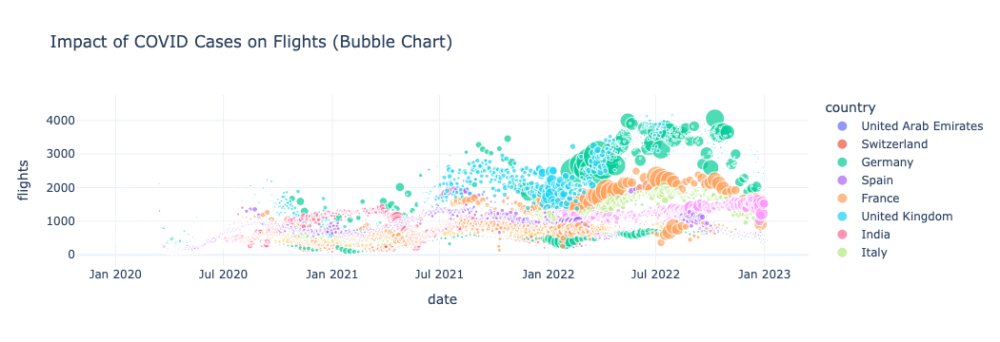

In [34]:
fig = px.scatter(
    merged_top15,
    x="date",
    y="flights",
    size="new_cases",
    color="country",
    hover_name="country",
    title="Impact of COVID Cases on Flights (Bubble Chart)",
    size_max=40,
    opacity=0.7
)

fig.update_layout(template="plotly_white")
fig.show()


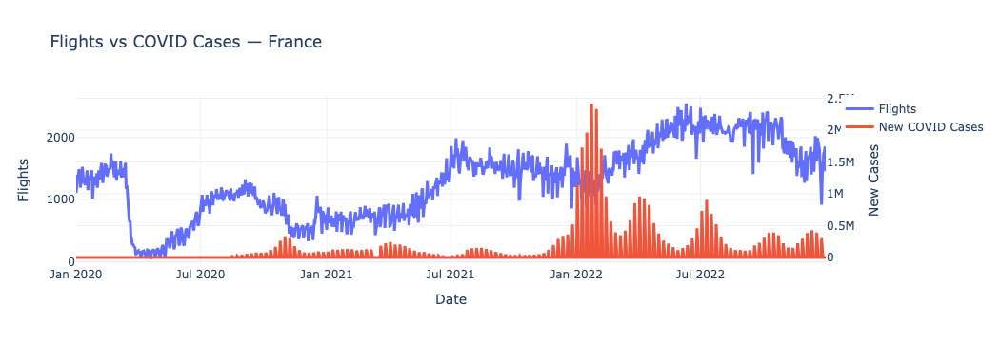

In [35]:
country_name = "France"   # ← change or make it dynamic

dfc = merged_top15[merged_top15["country"] == country_name]

fig = go.Figure()

# Flights line
fig.add_trace(go.Scatter(
    x=dfc['date'],
    y=dfc['flights'],
    name="Flights",
    mode="lines",
    line=dict(width=3)
))

# New cases line
fig.add_trace(go.Scatter(
    x=dfc['date'],
    y=dfc['new_cases'],
    name="New COVID Cases",
    mode="lines",
    yaxis="y2",
    line=dict(width=3)
))

# Layout
fig.update_layout(
    title=f"Flights vs COVID Cases — {country_name}",
    xaxis=dict(title="Date"),
    yaxis=dict(title="Flights"),
    yaxis2=dict(
        title="New Cases",
        overlaying="y",
        side="right"
    ),
    template="plotly_white"
)

fig.show()
